In [ ]:
# default_exp wild_fred

In [ ]:
import torch
import FRED
from FRED.datasets import *
from FRED.data_processing import *
from FRED.embed import *
from FRED.trainers import *
if torch.__version__[:4] == '1.13': # If using pytorch with MPS, use Apple silicon GPU acceleration
    device = torch.device("cuda" if torch.cuda.is_available() else 'mps' if torch.has_mps else "cpu")
else:
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device", device)
%load_ext autoreload
%autoreload 2

Using device cuda


In [ ]:
import torch.nn as nn
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm, trange

class ManifoldFlowEmbedder(torch.nn.Module):
    def __init__(
        self,
        dataloader,
        embedding_dimension=2,
        embedder_shape=[3, 4, 8, 4, 2],
        device=torch.device("cuda" if torch.cuda.is_available() else "cpu"),
        sigma=0.5,
        flow_strength=0.5,
        smoothness_grid=True,
        loss_weights = {
            "reconstruction": 0,
            "distance regularization": 1,
            "flow neighbor loss": 1e-4,
            "smoothness": 0
                       }
    ):
        super().__init__()
        # data
        self.dataloader = dataloader
        
        # misc
        self.device = device
        self.embedding_dimension = embedding_dimension
        # embedding parameters
        self.sigma = sigma
        self.flow_strength = flow_strength
        self.smoothness_grid = smoothness_grid
        # Initialize autoencoder and flow artist
        self.embedder, self.decoder = auto_encoder(embedder_shape, device=self.device)
        self.flowArtist = flow_artist(dim=self.embedding_dimension, device=self.device)
        # training ops
        self.KLD = nn.KLDivLoss(reduction="batchmean", log_target=False)
        self.MSE = nn.MSELoss()
        self.optim = torch.optim.Adam(self.parameters())
        # self.KLD = homemade_KLD # when running on mac
        self.epsilon = 1e-6  # set zeros to eps
        
        # loss weights
        self.loss_weights = loss_weights
        
    def loss(self, data, loss_weights):
        # set up
        self.embedded_points = self.embedder(data["X"])
        self.embedded_flows = self.flowArtist(self.embedded_points)
        
        # compute autoencoder loss
        losses = {}
        if loss_weights["reconstruction"] != 0:
            X_reconstructed = self.decoder(self.embedded_points)
            losses["reconstruction"] = self.MSE(X_reconstructed, data["X"])
        # Compute diffusion map loss
        if loss_weights["distance regularization"] != 0:
            diffmap_loss = precomputed_distance_loss(
                data["precomputed distances"], self.embedded_points
            )
            #           diffmap_loss = diffusion_map_loss(self.P_graph_ts[0], self.embedded_points)
            losses["distance regularization"] = diffmap_loss

        # Compute flow neighbor loss
        if loss_weights["flow neighbor loss"] != 0:
            neighbor_loss = flow_neighbor_loss(
                data["neighbors"],
                self.embedded_points,
                self.embedded_flows,
            )
            losses["flow neighbor loss"] = neighbor_loss

        # Compute smoothness regularization
        if loss_weights["smoothness"] != 0:
            smoothness_loss = smoothness_of_vector_field(
                self.embedded_points,
                self.flowArtist,
                device=self.device,
                grid_width=20,
                use_grid=self.smoothness_grid,
            )
            losses["smoothness"] = smoothness_loss
        return losses
    
    def weight_losses(self, losses):
        cost = 0
        for loss_name in losses.keys():
            cost += self.loss_weights[loss_name] * losses[loss_name]
        return cost
    
    def visualize_points(self, labels = dataloader.dataset.labels):
        X = dataloader.dataset.X.to(device)
        embedded_points = self.embedder(X)
        
        xmin = float(torch.min(embedded_points[:,0]))
        xmax = float(torch.max(embedded_points[:,0]))
        ymin = float(torch.min(embedded_points[:,1]))
        ymax = float(torch.max(embedded_points[:,1]))
        
        gridxmin = xmin - (xmax-xmin)*0.2
        gridxmax = xmax + (xmax-xmin)*0.2
        gridymin = ymin - (ymax-ymin)*0.2
        gridymax = ymax + (ymax-ymin)*0.2
        
        x_grid = torch.arange(gridxmin, gridxmax, (gridxmax-gridxmin)/20)
        y_grid = torch.arange(gridymin, gridymax, (gridymax-gridymin)/20)
        
        grid = []
        
        for i in range(20):
            for j in range(20):
                grid.append([x_grid[i], y_grid[j]])
        
        grid = torch.tensor(grid).float().to(device)
        flow = self.flowArtist(grid)
        
        plt.scatter(embedded_points[:,0].cpu().detach(), embedded_points[:,1].cpu().detach(), c=labels)
        plt.quiver(grid[:,0].cpu().detach(),grid[:,1].cpu().detach(),flow[:,0].cpu().detach(),flow[:,1].cpu().detach())
        plt.show()
    
    def fit(self, n_epochs=100):
        for epoch_num in trange(n_epochs):
            self.visualize_points()
            for data in self.dataloader:
                self.optim.zero_grad()
                # update loss weights according to scheduling
                """
                if self.scheduler is not None:
                    self.loss_weights = self.scheduler(self.loss_weights)
                """
                # have model compute losses, compile them into cost using loss weights
                data['X'] = data['X'].to(device)
                data['P'] = data['P'].to(device)
                data['precomputed distances'] = data['precomputed distances'].to(device)
                losses = self.loss(data, self.loss_weights)
                cost = self.weight_losses(losses)
                # backpropogate and update model
                cost.backward()
                self.optim.step()

Set sigma =  0.06339086


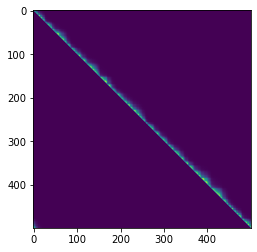

In [ ]:
from FRED.datasets import directed_circle
from FRED.data_processing import dataloader_from_ndarray
X, flow, labels = directed_circle()
# build dataset
dataloader = dataloader_from_ndarray(X,flow,labels)

In [ ]:
FRED = ManifoldFlowEmbedder(dataloader)

  0%|          | 0/200 [00:00<?, ?it/s]

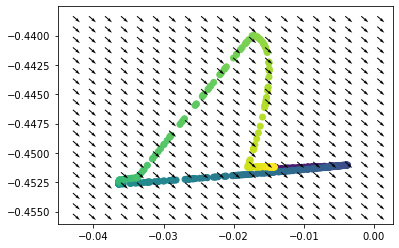

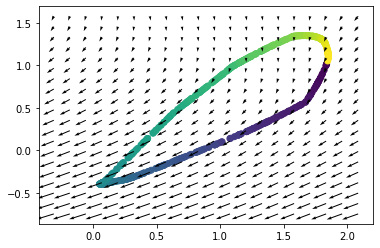

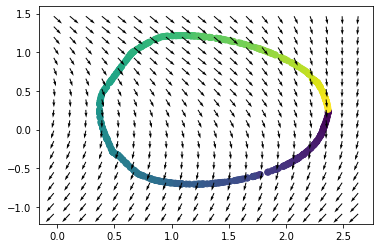

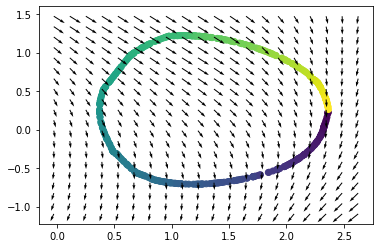

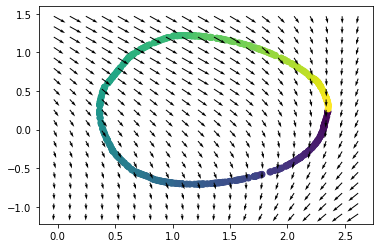

...

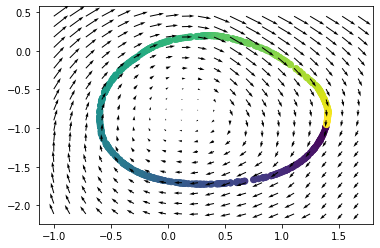

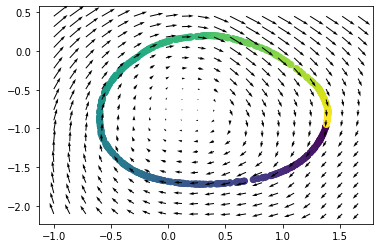

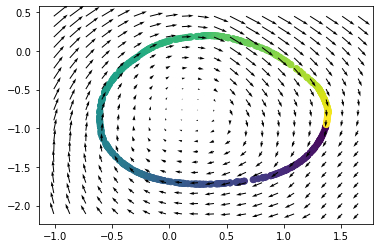

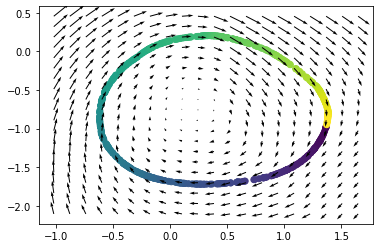

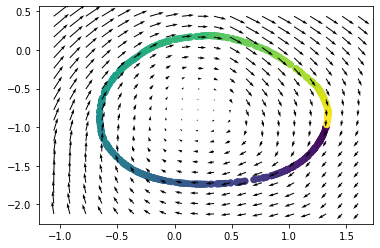

In [ ]:
FRED.fit(200)

[autoreload of FRED.trainers failed: Traceback (most recent call last):
  File "/gpfs/ysm/project/sumry2022/sumry2022_gt392/conda_envs/test/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 257, in check
    superreload(m, reload, self.old_objects)
  File "/gpfs/ysm/project/sumry2022/sumry2022_gt392/conda_envs/test/lib/python3.9/site-packages/IPython/extensions/autoreload.py", line 455, in superreload
    module = reload(module)
  File "/gpfs/ysm/project/sumry2022/sumry2022_gt392/conda_envs/test/lib/python3.9/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 613, in _exec
  File "<frozen importlib._bootstrap_external>", line 850, in exec_module
  File "<frozen importlib._bootstrap>", line 228, in _call_with_frames_removed
  File "/gpfs/ysm/project/sumry2022/sumry2022_gt392/FRED/FRED/trainers.py", line 23, in <module>
    class Trainer(object):
  File "/gpfs/ysm/project/sumry2022/sumry2022_gt392/

  0%|          | 0/200 [00:00<?, ?it/s]

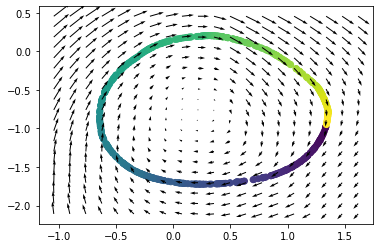

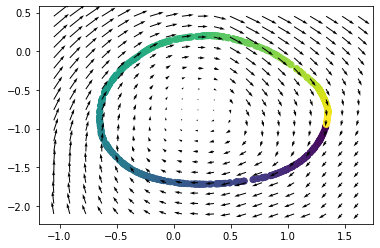

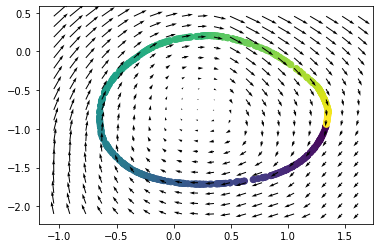

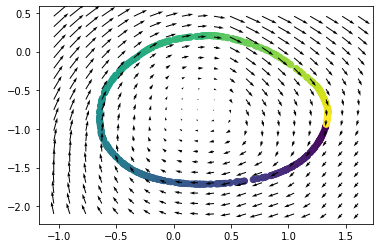

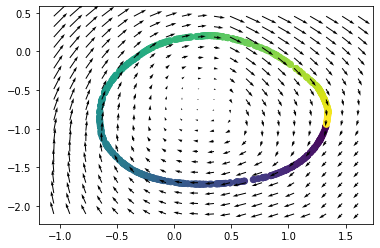

...

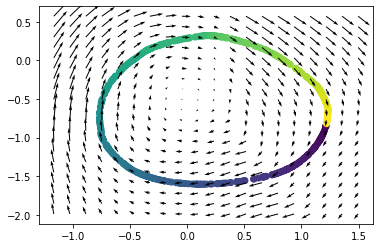

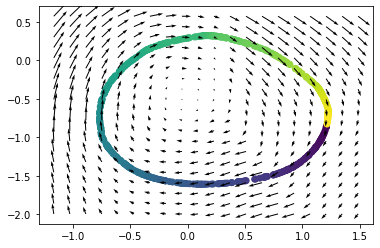

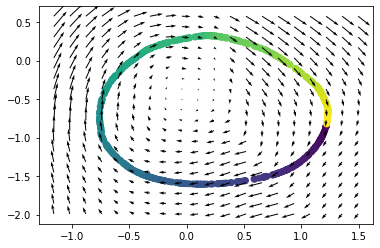

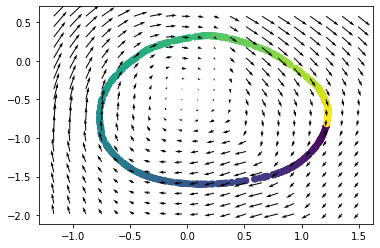

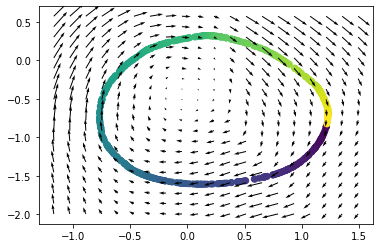

In [ ]:
FRED.fit(200)

Set sigma =  2.34158


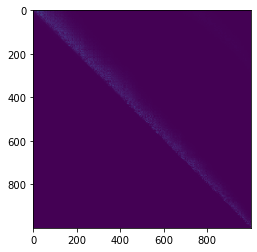

In [ ]:
from FRED.datasets import directed_swiss_roll_delayed
X, flow, labels = directed_swiss_roll_delayed()
# build dataset
dataloader_swiss_roll = dataloader_from_ndarray(X,flow,labels)

In [ ]:
FRED_swiss_roll = ManifoldFlowEmbedder(dataloader_swiss_roll)

In [ ]:
FRED_swiss_roll.fit(200)

  0%|          | 0/200 [00:00<?, ?it/s]

RuntimeError: mat1 and mat2 shapes cannot be multiplied (500x3 and 2x4)